In [ ]:
# Code based on https://machinelearningmastery.com/how-to-develop-a-pix2pix-gan-for-image-to-image-translation/

import numpy as np
from numpy.random import randint
import os

os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Activation, Dropout, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras.layers import BatchNormalization, Input, Concatenate, LeakyReLU, Conv2DTranspose
from tensorflow.keras.optimizers import Adam

if tf.test.gpu_device_name():
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
else:
    print("Please install GPU version of TF")


Default GPU Device: /device:GPU:0


In [ ]:
def load(image_file):
  """Loads the image and generates input and target image.

  Args:
    image_file: .jpeg file

  Returns:
    Input image, target image
  """
  image = tf.io.read_file(image_file)
  image = tf.image.decode_jpeg(image)

  w = tf.shape(image)[1]

  w = w // 2
  real_image = image[:, :w, :]
  input_image = image[:, w:, :]

  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  return input_image, real_image

In [ ]:
# Load pictures
import cv2
import random
import os
trainImgs = []
trainMaps = []
n = 0
length = len(os.listdir("/content/drive/MyDrive/pizza_samples"))
size = 256
for file in os.listdir("/content/drive/MyDrive/pizza_samples"):
    sampleA, sampleB = load(f"/content/drive/MyDrive/pizza_samples/{file}")
    #apple_image = cv2.resize(apple_image, (size,size))
    trainMaps.append(sampleA)
    trainImgs.append(sampleB)
    n += 1
    #print(f"loading {n}/{length}")


trainImgs = np.array(trainImgs)
trainMaps = np.array(trainMaps)
trainImgs = trainImgs/255.0
trainMaps = trainMaps/255.0

In [ ]:
trainImgs.shape

(1520, 256, 256, 3)

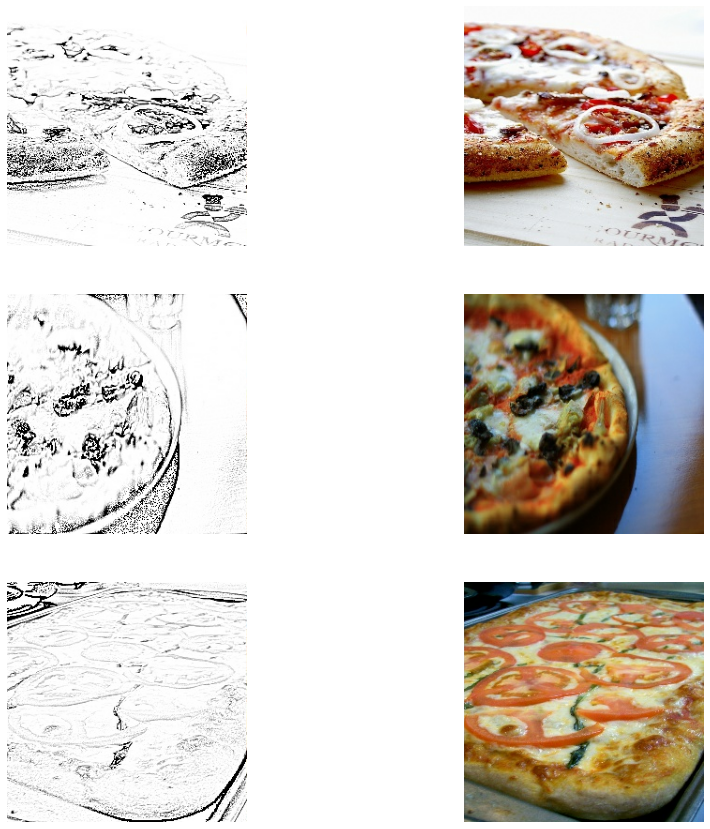

In [ ]:
import matplotlib.pyplot as plt
import random
plt.figure(figsize=(15, 15))
n = 3
x = 1
for i in range(n):
    ax = plt.subplot(3, 2, x)
    x = x + 1
    plt.imshow(trainImgs[i])
    plt.axis("off")
    ax = plt.subplot(3, 2, x)
    x = x + 1
    plt.imshow(trainMaps[i])
    plt.axis("off")
plt.show()

In [ ]:
# recalcuate to (-1,1)
trainImgs = (trainImgs - 0.5) / 0.5
trainMaps = (trainMaps - 0.5) / 0.5

In [ ]:
from tensorflow.keras.initializers import RandomNormal
# define the discriminator model
def define_discriminator(image_shape):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # source image input A
    in_src_image = Input(shape=image_shape)
    # target image input B
    in_target_image = Input(shape=image_shape)
    # concatenate images channel-wise
    merged = Concatenate()([in_src_image, in_target_image])
    # C64
    d = Conv2D(64, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(merged)
    d = LeakyReLU(alpha=0.2)(d)
    # C128
    d = Conv2D(128, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # C256
    d = Conv2D(256, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # C512
    d = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # second last output layer
    d = Conv2D(512, (4,4), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # patch output
    d = Conv2D(1, (4,4), padding='same', kernel_initializer=init)(d)
    patch_out = Activation('sigmoid')(d)
    # define model
    model = Model([in_src_image, in_target_image], patch_out)
    # compile model
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, loss_weights=[0.5])
    return model
d_model = define_discriminator((256,256,3))
d_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
concatenate (Concatenate)       (None, 256, 256, 6)  0           input_1[0][0]                    
                                                                 input_2[0][0]                    
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 128, 128, 64) 6208        concatenate[0][0]            

In [ ]:
# define an encoder block
def encoder_block(layer_in, n_filters, batchnorm=True):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # add downsampling layer
    g = Conv2D(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
    # conditionally add batch normalization
    if batchnorm:
        g = BatchNormalization()(g, training=True)
    # leaky relu activation
    g = LeakyReLU(alpha=0.2)(g)
    return g

# define a decoder block
def decoder_block(layer_in, skip_in, n_filters, dropout=True):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # add upsampling layer
    g = Conv2DTranspose(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
    # add batch normalization
    g = BatchNormalization()(g, training=True)
    # conditionally add dropout
    if dropout:
        g = Dropout(0.5)(g, training=True)
    # merge with skip connection
    g = Concatenate()([g, skip_in])
    # relu activation
    g = Activation('relu')(g)
    return g

# define the standalone generator model
def define_generator(image_shape=(256,256,3)):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # image input
    in_image = Input(shape=image_shape)
    # encoder model
    e1 = encoder_block(in_image, 64, batchnorm=False)
    e2 = encoder_block(e1, 128)
    e3 = encoder_block(e2, 256)
    e4 = encoder_block(e3, 512)
    e5 = encoder_block(e4, 512)
    e6 = encoder_block(e5, 512)
    e7 = encoder_block(e6, 512)
    # bottleneck, no batch norm and relu
    b = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(e7)
    b = Activation('relu')(b)
    # decoder model
    d1 = decoder_block(b, e7, 512)
    d2 = decoder_block(d1, e6, 512)
    d3 = decoder_block(d2, e5, 512)
    d4 = decoder_block(d3, e4, 512, dropout=False)
    d5 = decoder_block(d4, e3, 256, dropout=False)
    d6 = decoder_block(d5, e2, 128, dropout=False)
    d7 = decoder_block(d6, e1, 64, dropout=False)
    # output
    g = Conv2DTranspose(3, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d7)
    out_image = Activation('tanh')(g)
    # define model
    model = Model(in_image, out_image)
    return model
    
g_model = define_generator()
g_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_6 (Conv2D)               (None, 128, 128, 64) 3136        input_3[0][0]                    
__________________________________________________________________________________________________
leaky_re_lu_5 (LeakyReLU)       (None, 128, 128, 64) 0           conv2d_6[0][0]                   
__________________________________________________________________________________________________
conv2d_7 (Conv2D)               (None, 64, 64, 128)  131200      leaky_re_lu_5[0][0]              
____________________________________________________________________________________________

In [ ]:
# define the combined generator and discriminator model, for updating the generator
def define_gan(g_model, d_model, image_shape):
    # make weights in the discriminator not trainable
    for layer in d_model.layers:
        if not isinstance(layer, BatchNormalization):
            layer.trainable = False
    # define the source image
    in_src = Input(shape=image_shape)
    # connect the source image to the generator input
    gen_out = g_model(in_src)
    # connect the source input and generator output to the discriminator input
    dis_out = d_model([in_src, gen_out])
    # src image as input, generated image and classification output
    model = Model(in_src, [dis_out, gen_out])
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss=['binary_crossentropy', 'mae'], optimizer=opt, loss_weights=[1,100])
    return model
gan_model = define_gan(g_model, d_model, (256,256,3))

In [ ]:
# select a batch of random samples, returns images and target
def generate_real_samples(samples):
    ix = randint(0, trainImgs.shape[0], samples)
    X1, X2 = trainImgs[ix], trainMaps[ix]
    return X1, X2

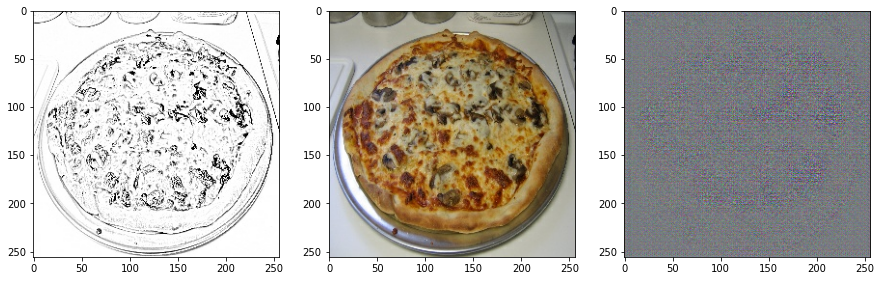

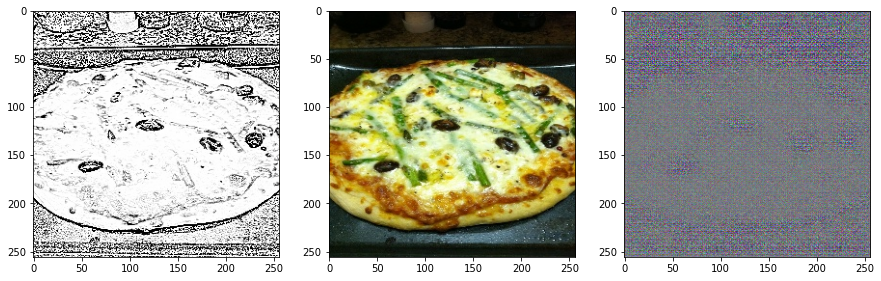

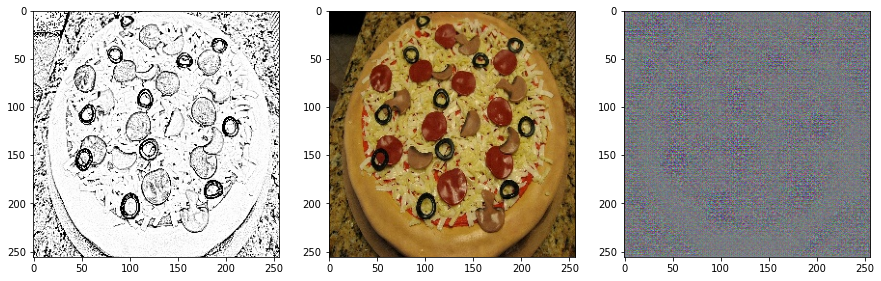

In [ ]:
def show_results(step, g_model, samples=3):
    # select a sample of input images
    realA, realB = generate_real_samples(samples)
    fakeB = g_model.predict(realA[:samples])
    realA = (realA+1.0)/2.0
    realB = (realB+1)/2
    fakeB = (fakeB+1)/2
    
    for i in range(samples):
        plt.figure(figsize=(15, 15))
        ax = plt.subplot(1, 3, 1)
        plt.imshow(realA[i])
        ax = plt.subplot(1, 3, 2)
        plt.imshow(realB[i])
        ax = plt.subplot(1, 3, 3)
        plt.imshow(fakeB[i])
    plt.show()
show_results(0,g_model,3)

In [ ]:
# train pix2pix model
def train(d_model, g_model, gan_model, epochs=100, batch=1):
    # determine the output square shape of the discriminator
    patch = d_model.output_shape[1]
    steps = int(len(trainImgs) / batch)
    all_ones = np.ones((batch, patch, patch, 1))
    all_zeros = np.zeros((batch, patch, patch, 1))
    # manually enumerate epochs
    for epoch in range(epochs):
        show_results(epoch, g_model, samples=1)
        print(f"Calculating next {steps} batches of size {batch}")
        for i in range(steps):
            # select a batch of real samples
            realA, realB = generate_real_samples(batch)
            # generate a batch of fake samples
            fakeB = g_model.predict(realA)
            # update discriminator for real samples
            d_loss_real = d_model.train_on_batch([realA, realB], all_ones )
            # update discriminator for generated samples
            d_loss_fake = d_model.train_on_batch([realA, fakeB], all_zeros)
            # update the generator
            g_loss, _, _ = gan_model.train_on_batch(realA, [all_ones, realB])
            #print(f"Iteration {i}/{n_steps} g_loss={g_loss:.3f}, d_loss_real={d_loss_real:.3f}, d_loss_fake={d_loss_fake:.3f}")
            print(".",end='')
        print()    
        print(f"Epoch {epoch} g_loss={g_loss:.3f}, d_loss_real={d_loss_real:.3f}, d_loss_fake={d_loss_fake:.3f}")

In [ ]:
# load image data
image_shape = (256,256,3) #dataset[0].shape[1:]
# define the models
d_model = define_discriminator(image_shape)
g_model = define_generator(image_shape)
# define the composite model
gan_model = define_gan(g_model, d_model, image_shape)

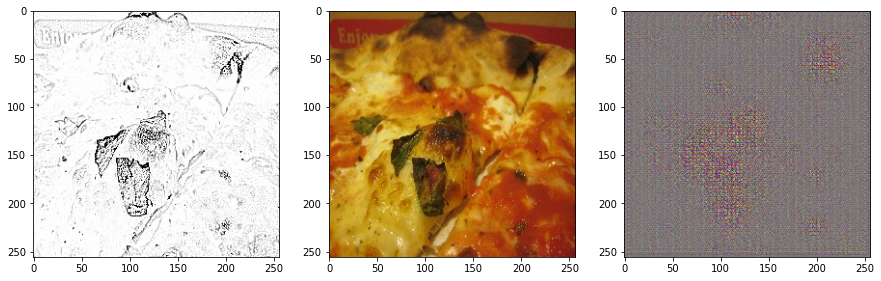

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 0 g_loss=29.075, d_loss_real=0.186, d_loss_fake=0.033


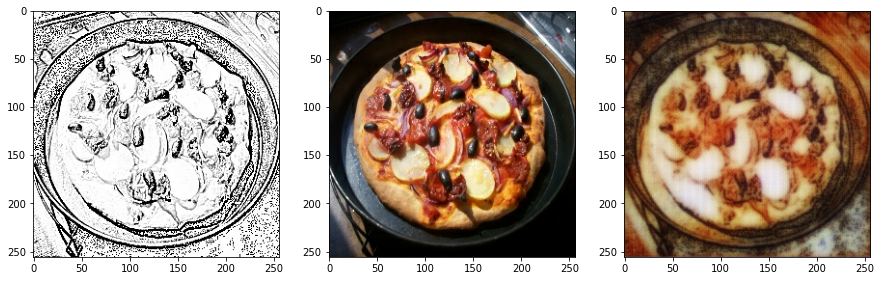

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 1 g_loss=23.992, d_loss_real=0.363, d_loss_fake=0.214


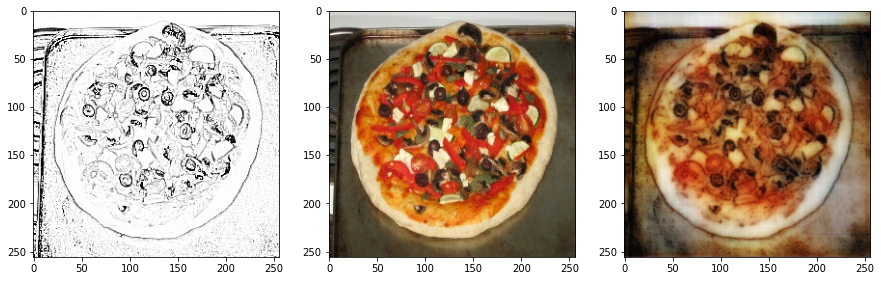

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 2 g_loss=26.213, d_loss_real=0.065, d_loss_fake=0.116


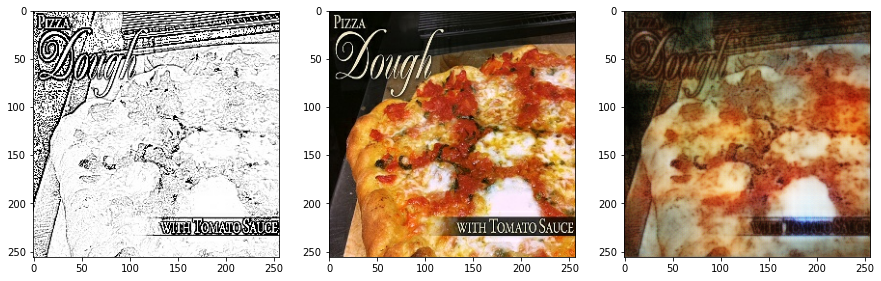

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 3 g_loss=24.485, d_loss_real=0.099, d_loss_fake=0.241


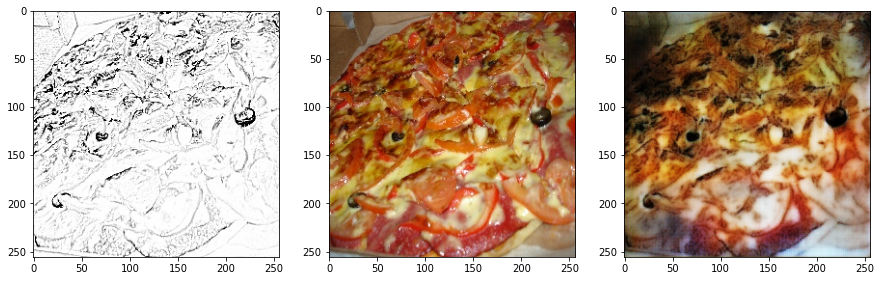

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 4 g_loss=25.000, d_loss_real=0.339, d_loss_fake=0.615


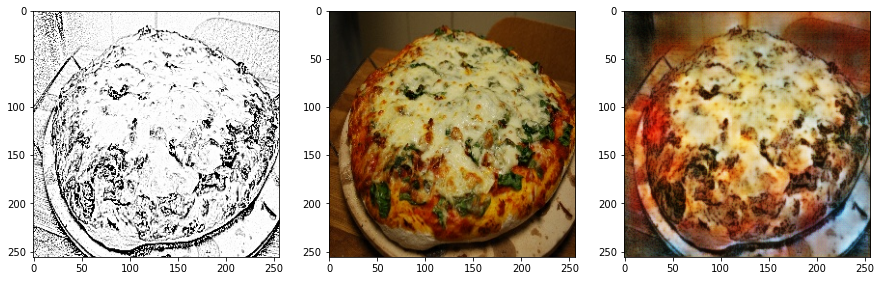

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 5 g_loss=21.687, d_loss_real=0.114, d_loss_fake=0.187


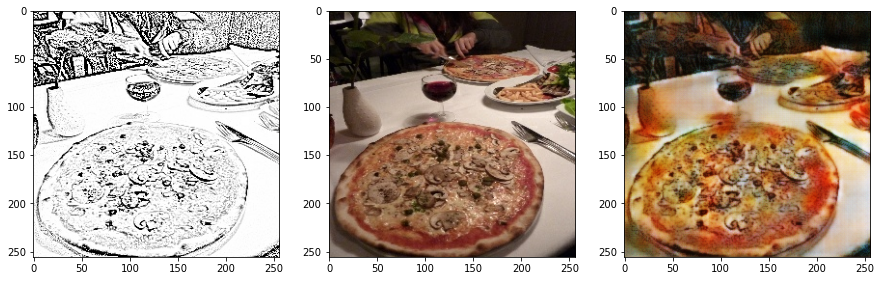

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 6 g_loss=22.161, d_loss_real=0.073, d_loss_fake=0.218


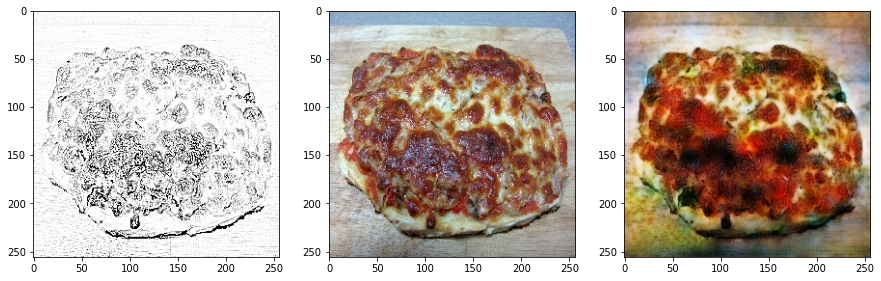

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 7 g_loss=20.461, d_loss_real=0.107, d_loss_fake=0.404


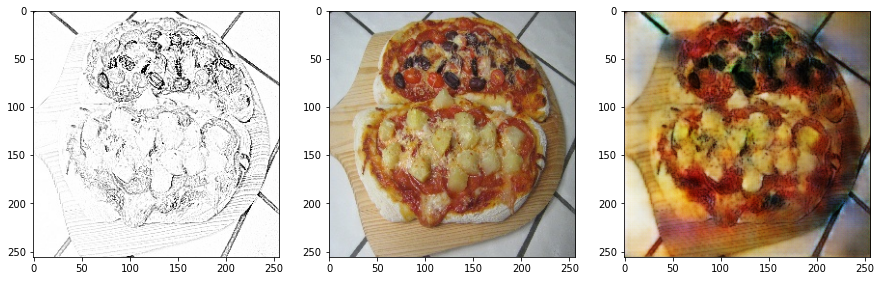

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 8 g_loss=19.404, d_loss_real=0.420, d_loss_fake=0.479


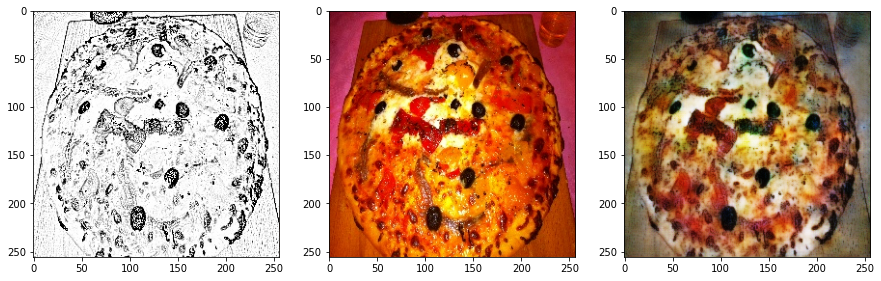

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 9 g_loss=20.943, d_loss_real=0.171, d_loss_fake=0.215


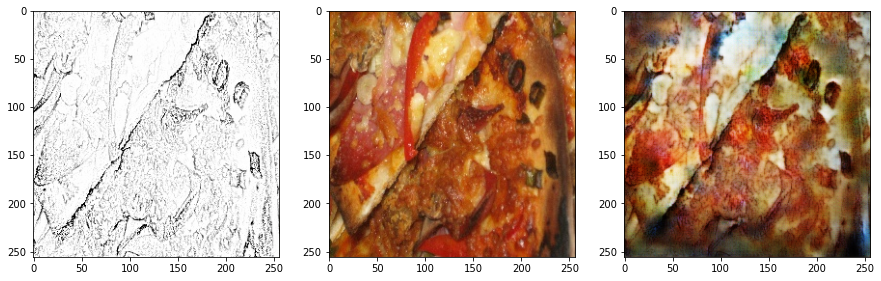

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 10 g_loss=19.764, d_loss_real=0.091, d_loss_fake=0.298


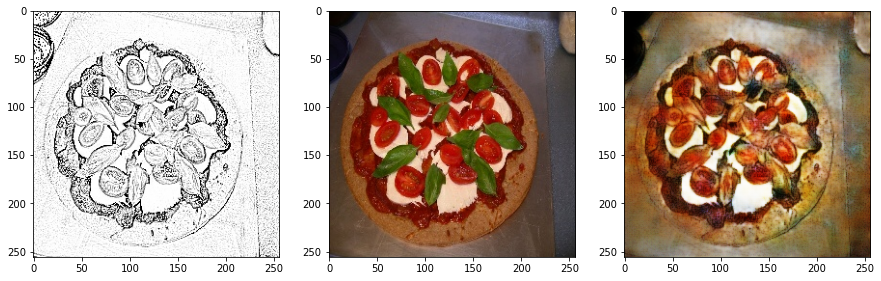

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 11 g_loss=17.676, d_loss_real=0.848, d_loss_fake=0.165


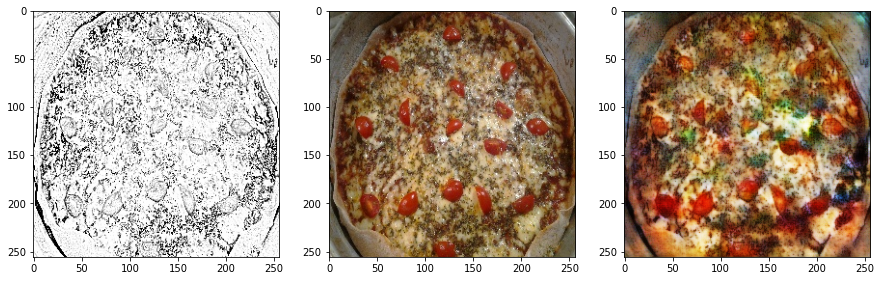

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 12 g_loss=17.814, d_loss_real=0.359, d_loss_fake=0.250


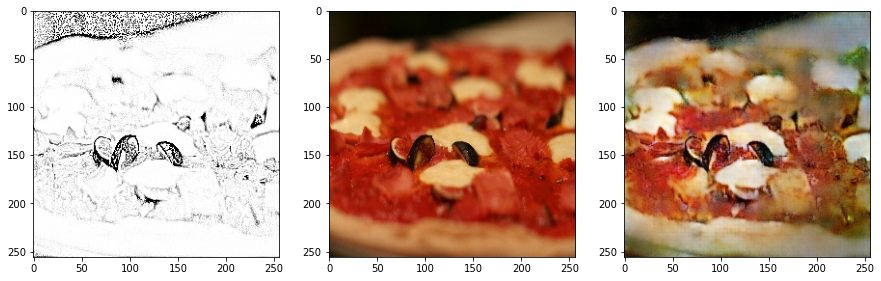

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 13 g_loss=19.513, d_loss_real=0.068, d_loss_fake=0.190


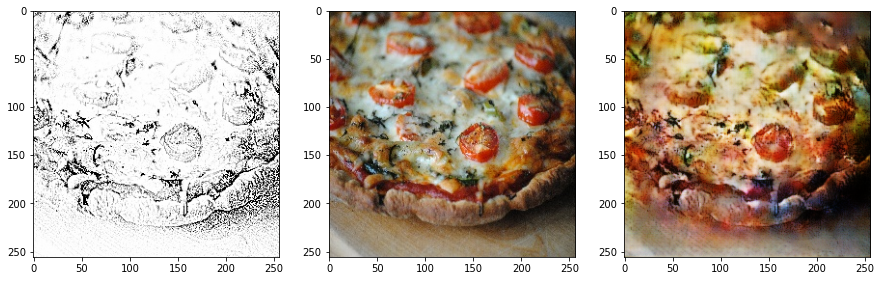

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 14 g_loss=16.457, d_loss_real=0.612, d_loss_fake=0.282


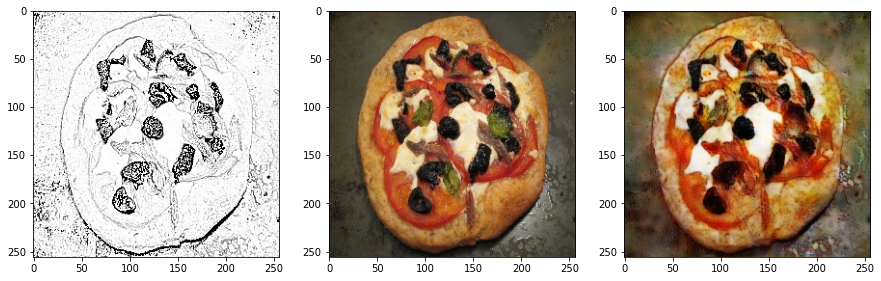

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 15 g_loss=18.336, d_loss_real=0.108, d_loss_fake=0.176


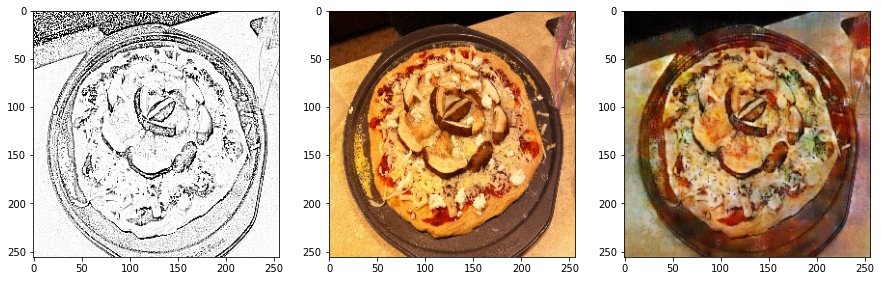

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 16 g_loss=15.315, d_loss_real=0.361, d_loss_fake=0.294


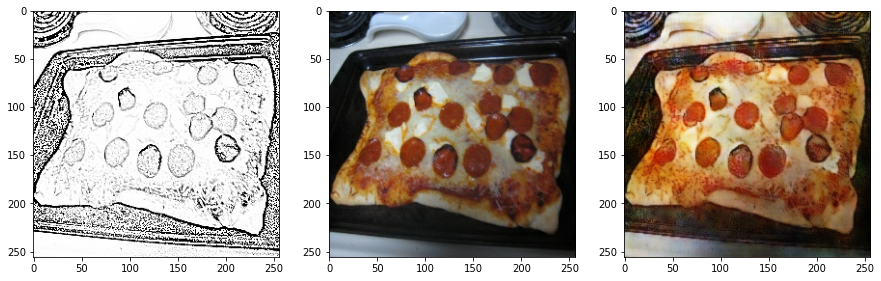

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 17 g_loss=16.258, d_loss_real=0.293, d_loss_fake=0.303


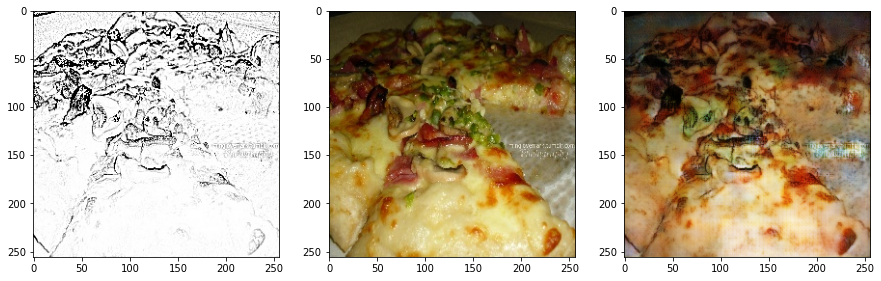

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 18 g_loss=15.112, d_loss_real=0.170, d_loss_fake=0.343


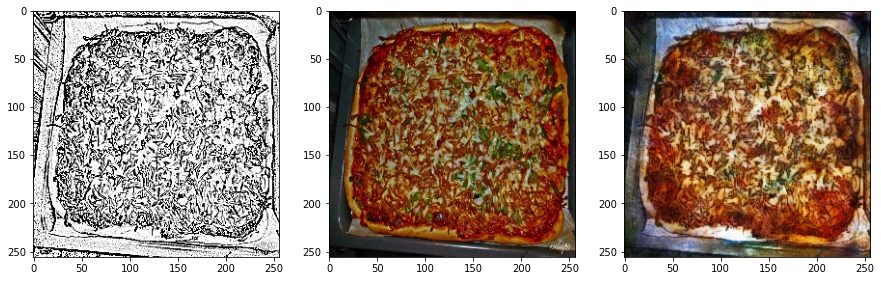

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 19 g_loss=16.272, d_loss_real=0.389, d_loss_fake=0.289


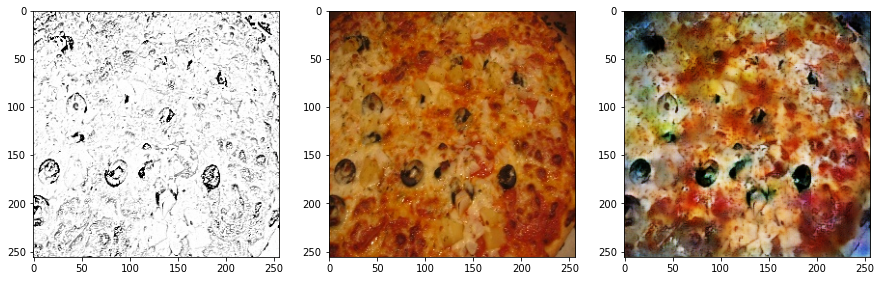

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 20 g_loss=14.587, d_loss_real=0.285, d_loss_fake=0.403


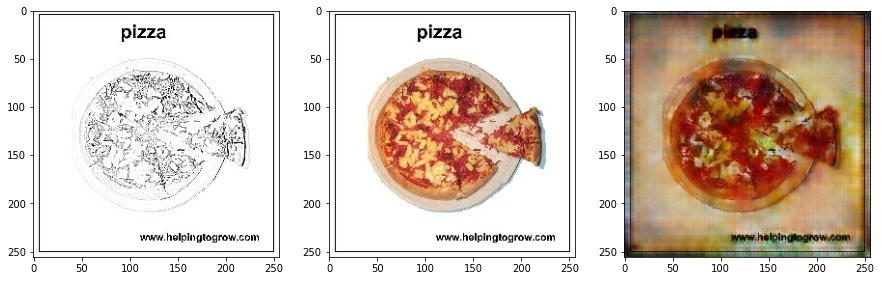

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 21 g_loss=14.255, d_loss_real=0.651, d_loss_fake=0.219


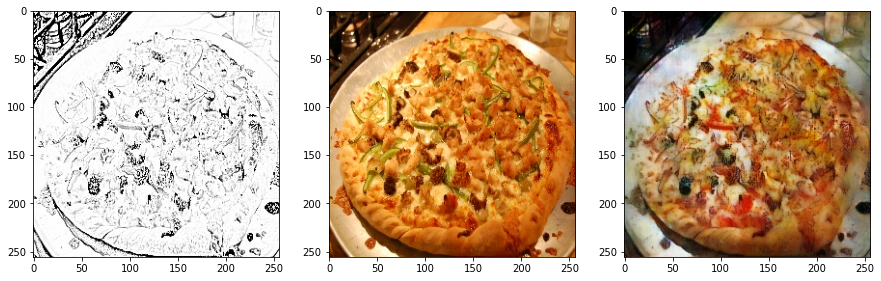

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 22 g_loss=14.970, d_loss_real=0.081, d_loss_fake=0.276


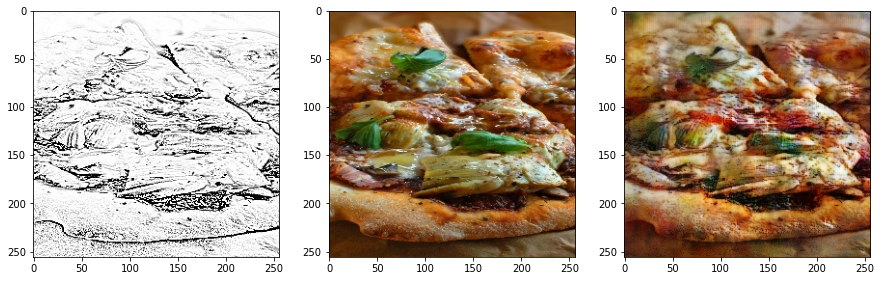

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 23 g_loss=12.750, d_loss_real=0.616, d_loss_fake=0.285


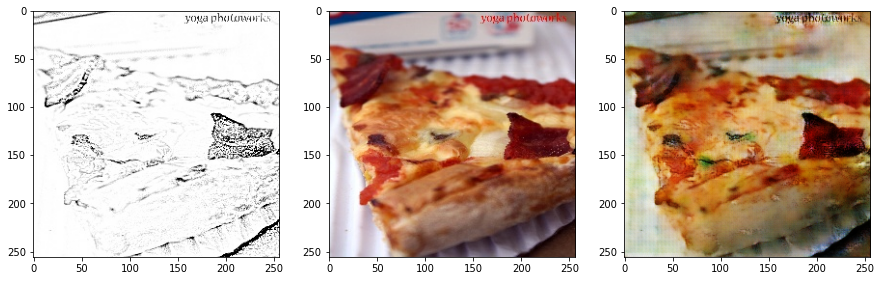

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 24 g_loss=15.537, d_loss_real=0.165, d_loss_fake=0.242


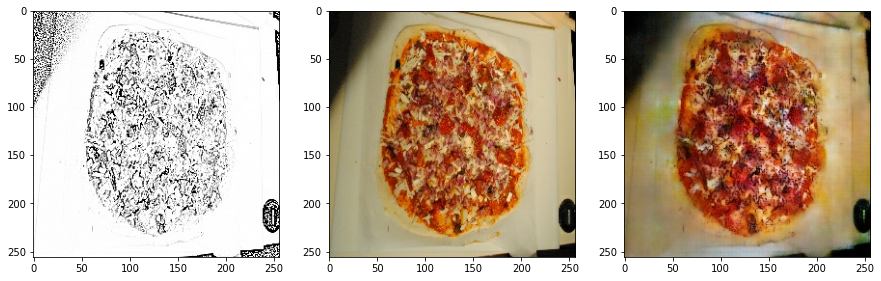

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 25 g_loss=18.511, d_loss_real=0.190, d_loss_fake=0.297


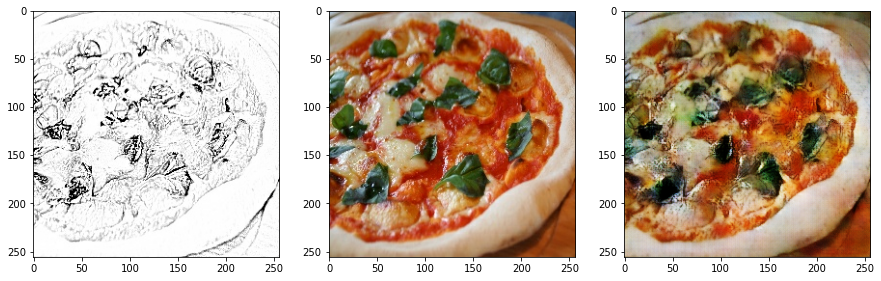

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 26 g_loss=19.832, d_loss_real=0.083, d_loss_fake=0.233


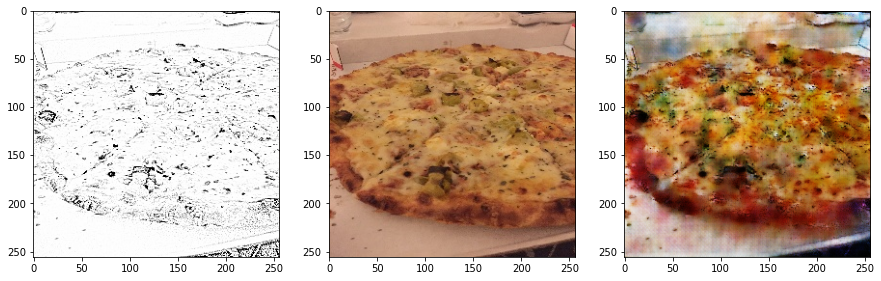

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 27 g_loss=14.190, d_loss_real=0.117, d_loss_fake=0.148


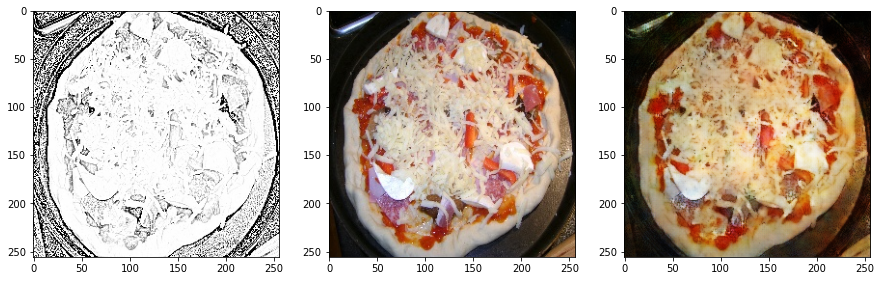

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 28 g_loss=13.652, d_loss_real=0.149, d_loss_fake=0.357


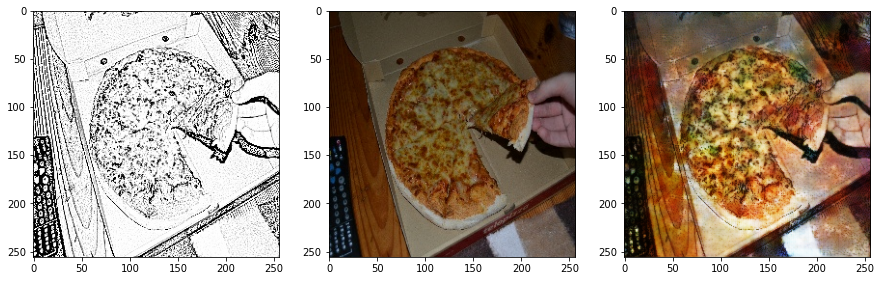

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 29 g_loss=16.592, d_loss_real=0.048, d_loss_fake=0.191


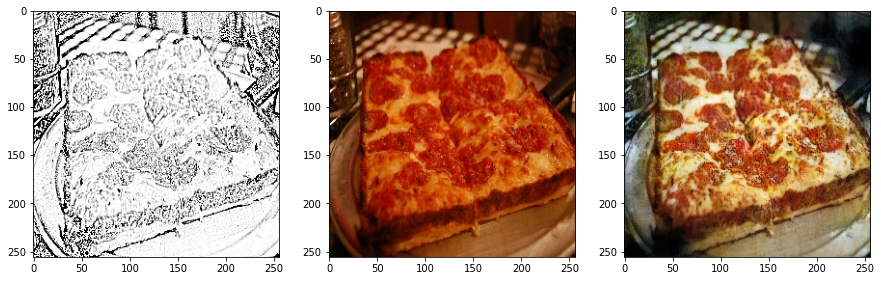

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 30 g_loss=13.722, d_loss_real=0.150, d_loss_fake=0.203


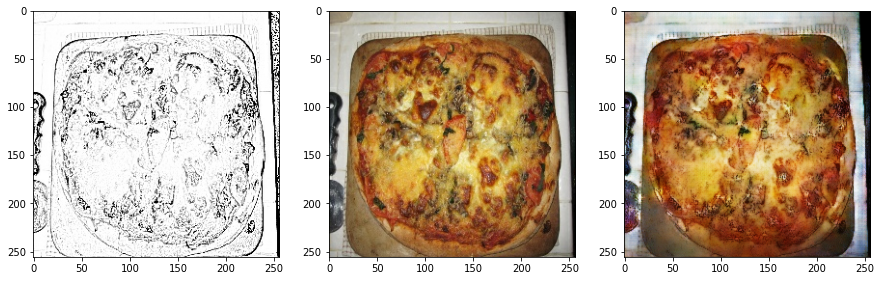

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 31 g_loss=12.439, d_loss_real=0.619, d_loss_fake=0.266


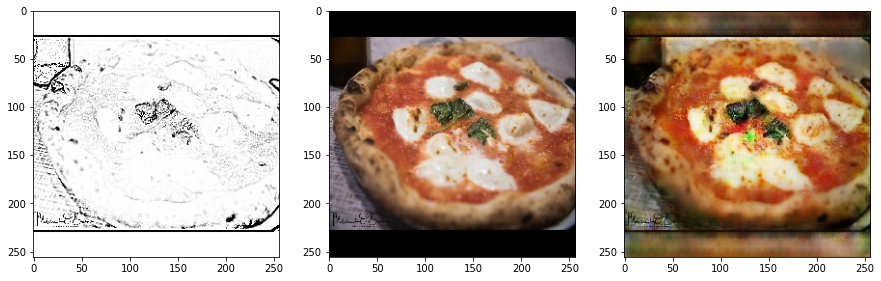

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 32 g_loss=13.793, d_loss_real=0.439, d_loss_fake=0.172


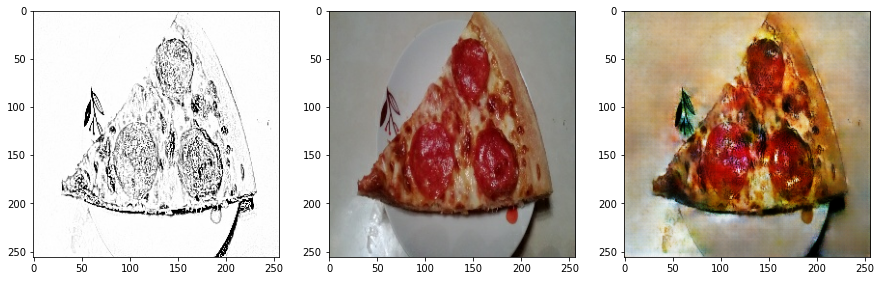

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 33 g_loss=13.925, d_loss_real=0.074, d_loss_fake=0.329


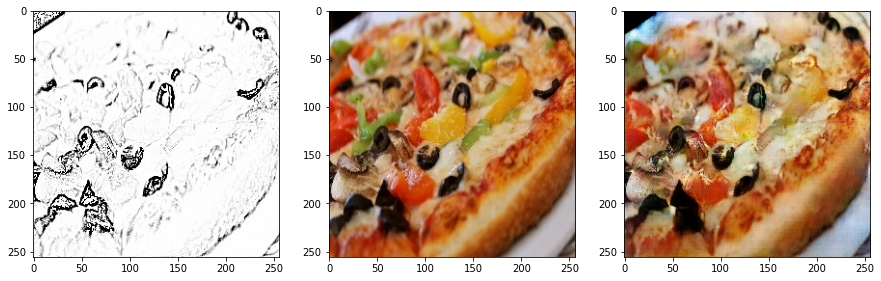

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 34 g_loss=13.336, d_loss_real=0.096, d_loss_fake=0.181


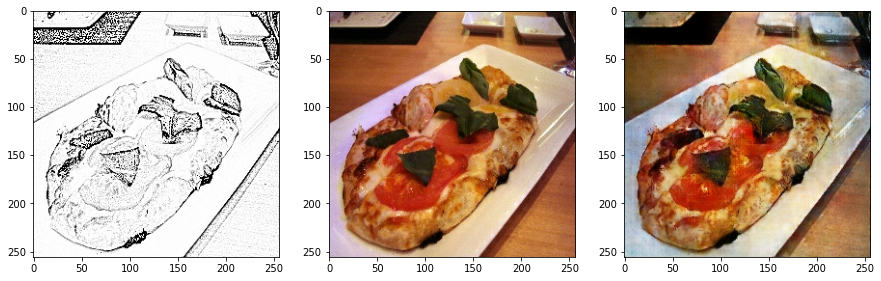

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 35 g_loss=13.324, d_loss_real=0.188, d_loss_fake=0.262


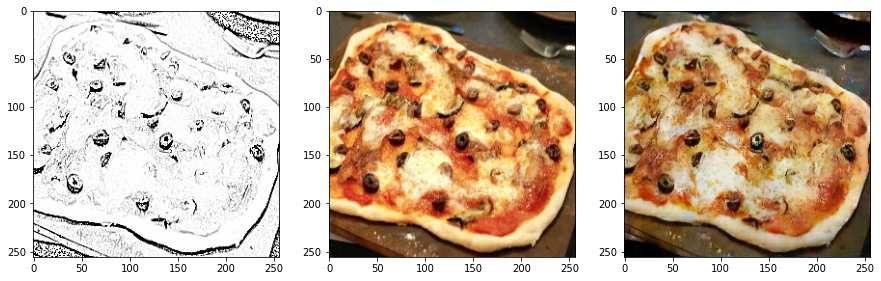

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 36 g_loss=14.109, d_loss_real=0.042, d_loss_fake=0.333


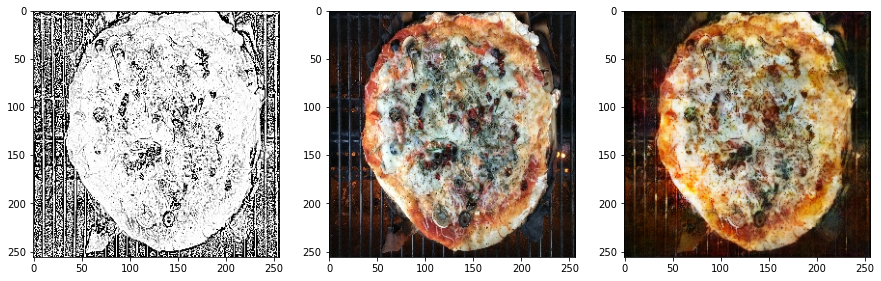

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 37 g_loss=13.643, d_loss_real=0.143, d_loss_fake=0.320


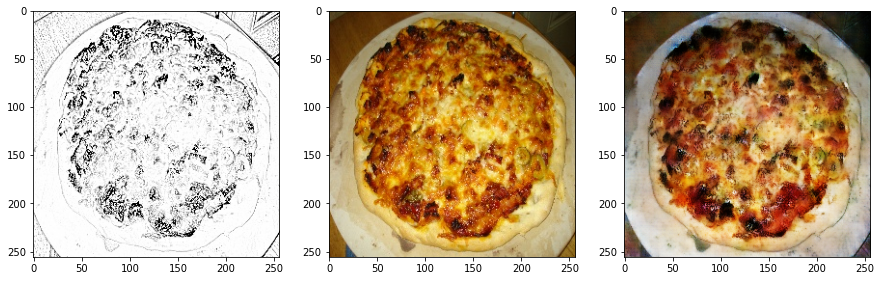

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 38 g_loss=12.368, d_loss_real=0.132, d_loss_fake=0.363


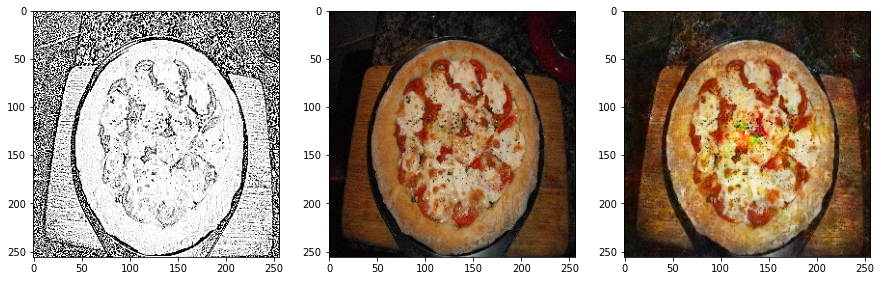

Calculating next 190 batches of size 8
..............................................................................................................................................................................................
Epoch 39 g_loss=11.822, d_loss_real=0.215, d_loss_fake=0.286


In [ ]:
# train model
train(d_model, g_model, gan_model, 40, 8)